<a href="https://colab.research.google.com/github/allseenn/neuronet/blob/main/06.Tasks/dubai.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Нейронные сети

## ДЗ № 6. Сегментация

## Космические снимки Дубаи со спутника

Основной датасет взят отсюда https://humansintheloop.org/resources/datasets/semantic-segmentation-dataset-2/

Он содержит 72 изображения снимков земли и соответсвующих им 72 изображения с масками

В качестве валидационных данних, буду использовать две тестовые картинки из архива test.zip к шестому семинару.

In [1]:
import pickle
import numpy as np
import pandas as pd
from PIL import Image
import albumentations as A
from IPython.display import SVG
import matplotlib.pyplot as plt
%matplotlib inline
import os, re, sys, random, shutil, cv2

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam, Nadam
from tensorflow.keras import applications, optimizers
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.applications.resnet50 import preprocess_input

from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import model_to_dot, plot_model
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, CSVLogger, LearningRateScheduler
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, ZeroPadding2D, Dropout

### Аугментация

Обучающий датасет (картинки и их маски) будет создан на базе основного набора с помощью аугментации, использую библиотеку albumentations.

На выходе получим 576 картинок и 576 их масок.

Следующие изменения основных картиноку будут произведены с поомщью аугментации:
1. Случайная обрезка
2. Горизонтальное смещение
3. Вертикальное смещение
4. Вращение
6. Случайное осветление и изменение контраста
7. Размытие по сетке
8. Оптическое размытие


In [2]:
def augment(width, height):
    transform = A.Compose([
        A.RandomCrop(width=width, height=height, p=1.0),
        A.HorizontalFlip(p=1.0),
        A.VerticalFlip(p=1.0),
        A.Rotate(limit=[60, 300], p=1.0, interpolation=cv2.INTER_NEAREST),
        A.RandomBrightnessContrast(brightness_limit=[-0.2, 0.3], contrast_limit=0.2, p=1.0),
        A.OneOf([
            A.CLAHE (clip_limit=1.5, tile_grid_size=(8, 8), p=0.5),
            A.GridDistortion(p=0.5),
            A.OpticalDistortion(distort_limit=1, shift_limit=0.5, interpolation=cv2.INTER_NEAREST, p=0.5),
        ], p=1.0),
    ], p=1.0)

    return transform

In [3]:
def visualize(image, mask, original_image=None, original_mask=None):
    fontsize = 16

    if original_image is None and original_mask is None:
        f, ax = plt.subplots(2, 1, figsize=(10, 10), squeeze=True)
        f.set_tight_layout(h_pad=5, w_pad=5)

        ax[0].imshow(image)
        ax[1].imshow(mask)
    else:
        f, ax = plt.subplots(2, 2, figsize=(16, 12), squeeze=True)
        plt.tight_layout(pad=0.2, w_pad=1.0, h_pad=0.01)

        ax[0, 0].imshow(original_image)
        ax[0, 0].set_title('Оригинальное изображение', fontsize=fontsize)

        ax[1, 0].imshow(original_mask)
        ax[1, 0].set_title('Оригинальная маска', fontsize=fontsize)

        ax[0, 1].imshow(image)
        ax[0, 1].set_title('Измененное изображение', fontsize=fontsize)

        ax[1, 1].imshow(mask)
        ax[1, 1].set_title('Измененная маска', fontsize=fontsize)

    plt.savefig('sample_augmented_image.png', facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 100)

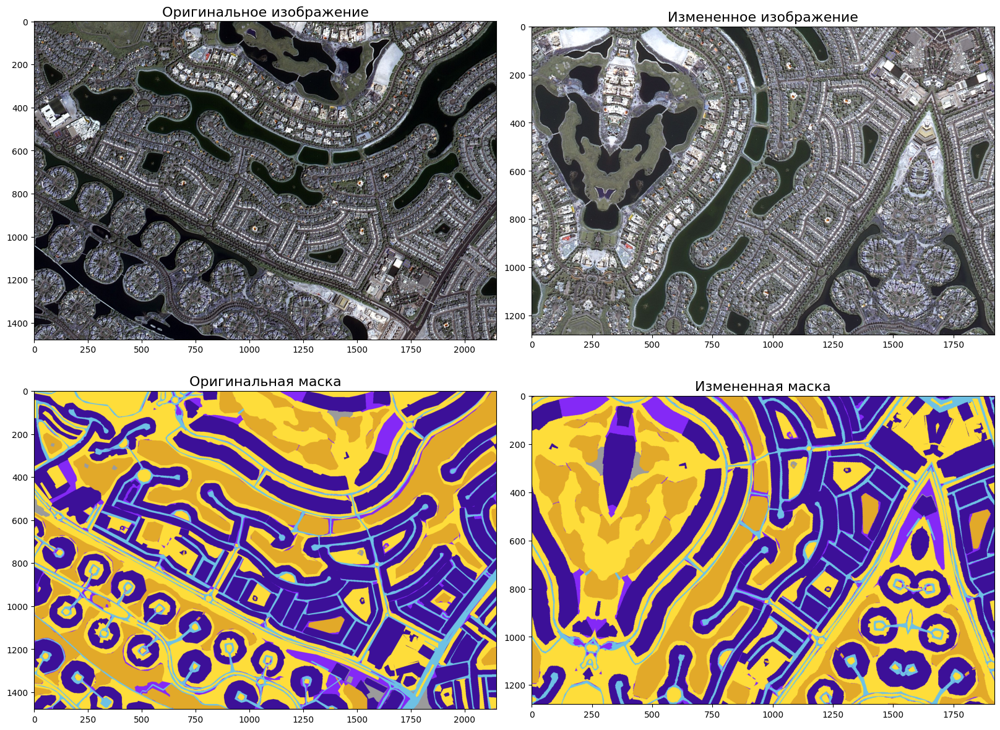

In [4]:
image = cv2.imread
image = cv2.imread("drive/MyDrive/input/dubai-aerial-imagery-dataset/train_images/train/image_t8_007.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
mask = cv2.imread("drive/MyDrive/input/dubai-aerial-imagery-dataset/train_masks/train/image_t8_007.png")
mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)

transform = augment(1920, 1280)
transformed = transform(image=image, mask=mask)
transformed_image = transformed['image']
transformed_mask = transformed['mask']

cv2.imwrite('drive/MyDrive/image.png',cv2.cvtColor(transformed_image, cv2.COLOR_BGR2RGB))
cv2.imwrite('drive/MyDrive/mask.png',cv2.cvtColor(transformed_mask, cv2.COLOR_BGR2RGB))

visualize(transformed_image, transformed_mask, image, mask)

### Сохранение аугментнырованных картинок на диск

После создания структуры папок на диске.
Запускаем процесс аугментации.

Т.к. этот процесс я производил несколько раз, то буду использовать готовый набор из 576 картинок и 576 массок. Делаю это из-за соображений экономии ресурсов колаба.

In [ ]:
!mkdir -p drive/MyDrive/aug_images/train
!mkdir -p drive/MyDrive/aug_masks/train

In [5]:
images_dir = 'drive/MyDrive/input/dubai-aerial-imagery-dataset/train_images/train/'
masks_dir = 'drive/MyDrive/input/dubai-aerial-imagery-dataset/train_masks/train/'

In [6]:
file_names = np.sort(os.listdir(images_dir))
file_names = np.char.split(file_names, '.')
filenames = np.array([])
for i in range(len(file_names)):
    filenames = np.append(filenames, file_names[i][0])

filenames

array(['image_t1_001', 'image_t1_002', 'image_t1_003', 'image_t1_004',
       'image_t1_005', 'image_t1_006', 'image_t1_007', 'image_t1_008',
       'image_t1_009', 'image_t2_001', 'image_t2_002', 'image_t2_003',
       'image_t2_004', 'image_t2_005', 'image_t2_006', 'image_t2_007',
       'image_t2_008', 'image_t2_009', 'image_t3_001', 'image_t3_002',
       'image_t3_003', 'image_t3_004', 'image_t3_005', 'image_t3_006',
       'image_t3_007', 'image_t3_008', 'image_t3_009', 'image_t4_001',
       'image_t4_002', 'image_t4_003', 'image_t4_004', 'image_t4_005',
       'image_t4_006', 'image_t4_007', 'image_t4_008', 'image_t4_009',
       'image_t5_001', 'image_t5_002', 'image_t5_003', 'image_t5_004',
       'image_t5_005', 'image_t5_006', 'image_t5_007', 'image_t5_008',
       'image_t5_009', 'image_t6_001', 'image_t6_002', 'image_t6_003',
       'image_t6_004', 'image_t6_005', 'image_t6_006', 'image_t6_007',
       'image_t6_008', 'image_t6_009', 'image_t7_001', 'image_t7_002',
      

### Функция аугментации

In [ ]:
def augment_dataset(count):
    '''Функция аугментации для обучающего датасета
        Вход:
            count - количество картинок после аугментации = первоначальное количество картинок * count = 72 * 8 = 576
        Выход:
            записывам преобразованные данные (картинки и маски) в рабочию директорию
    '''
    transform_1 = augment(512, 512)
    transform_2 = augment(480, 480)
    transform_3 = augment(512, 512)
    transform_4 = augment(800, 800)
    transform_5 = augment(1024, 1024)
    transform_6 = augment(800, 800)
    transform_7 = augment(1600, 1600)
    transform_8 = augment(1920, 1280)
    # filenames = list(filter(lambda x: x != '', filenames))
    i = 0
    for i in range(count):
        for file in filenames:
            tile = file.split('_')[1]
            img = cv2.imread(images_dir+file+'.jpg')
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            mask = cv2.imread(masks_dir+file+'.png')
            mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)

            if tile == 't1':
                transformed = transform_1(image=img, mask=mask)
                transformed_image = transformed['image']
                transformed_mask = transformed['mask']
            elif tile =='t2':
                transformed = transform_2(image=img, mask=mask)
                transformed_image = transformed['image']
                transformed_mask = transformed['mask']
            elif tile =='t3':
                transformed = transform_3(image=img, mask=mask)
                transformed_image = transformed['image']
                transformed_mask = transformed['mask']
            elif tile =='t4':
                transformed = transform_4(image=img, mask=mask)
                transformed_image = transformed['image']
                transformed_mask = transformed['mask']
            elif tile =='t5':
                transformed = transform_5(image=img, mask=mask)
                transformed_image = transformed['image']
                transformed_mask = transformed['mask']
            elif tile =='t6':
                transformed = transform_6(image=img, mask=mask)
                transformed_image = transformed['image']
                transformed_mask = transformed['mask']
            elif tile =='t7':
                transformed = transform_7(image=img, mask=mask)
                transformed_image = transformed['image']
                transformed_mask = transformed['mask']
            elif tile =='t8':
                transformed = transform_8(image=img, mask=mask)
                transformed_image = transformed['image']
                transformed_mask = transformed['mask']

            cv2.imwrite('drive/MyDrive/aug_images/train/aug_{}_'.format(str(i+1))+file+'.jpg',cv2.cvtColor(transformed_image, cv2.COLOR_BGR2RGB))
            cv2.imwrite('drive/MyDrive/aug_masks/train/aug_{}_'.format(str(i+1))+file+'.png',cv2.cvtColor(transformed_mask, cv2.COLOR_BGR2RGB))

### Аугментация обучающего датасета

In [ ]:
augment_dataset(8)

### Папки с обучающим датасетом

In [7]:
train_images = "drive/MyDrive/aug_images/"
train_masks = "drive/MyDrive/aug_masks/"
val_images = "drive/MyDrive/val_images/"
val_masks = "drive/MyDrive/val_masks/"

### Список файлов обучающего датасета

In [8]:
file_names = np.sort(os.listdir(train_images + 'train/'))
file_names = np.char.split(file_names, '.')
filenames = np.array([])
for i in range(len(file_names)):
    filenames = np.append(filenames, file_names[i][0])

filenames

array(['aug_1_image_t1_001', 'aug_1_image_t1_002', 'aug_1_image_t1_003',
       'aug_1_image_t1_004', 'aug_1_image_t1_005', 'aug_1_image_t1_006',
       'aug_1_image_t1_007', 'aug_1_image_t1_008', 'aug_1_image_t1_009',
       'aug_1_image_t2_001', 'aug_1_image_t2_002', 'aug_1_image_t2_003',
       'aug_1_image_t2_004', 'aug_1_image_t2_005', 'aug_1_image_t2_006',
       'aug_1_image_t2_007', 'aug_1_image_t2_008', 'aug_1_image_t2_009',
       'aug_1_image_t3_001', 'aug_1_image_t3_002', 'aug_1_image_t3_003',
       'aug_1_image_t3_004', 'aug_1_image_t3_005', 'aug_1_image_t3_006',
       'aug_1_image_t3_007', 'aug_1_image_t3_008', 'aug_1_image_t3_009',
       'aug_1_image_t4_001', 'aug_1_image_t4_002', 'aug_1_image_t4_003',
       'aug_1_image_t4_004', 'aug_1_image_t4_005', 'aug_1_image_t4_006',
       'aug_1_image_t4_007', 'aug_1_image_t4_008', 'aug_1_image_t4_009',
       'aug_1_image_t5_001', 'aug_1_image_t5_002', 'aug_1_image_t5_003',
       'aug_1_image_t5_004', 'aug_1_image_t5_005', 

### Примеры из датасета

Вывод примеров оригинальных изображений и их масок

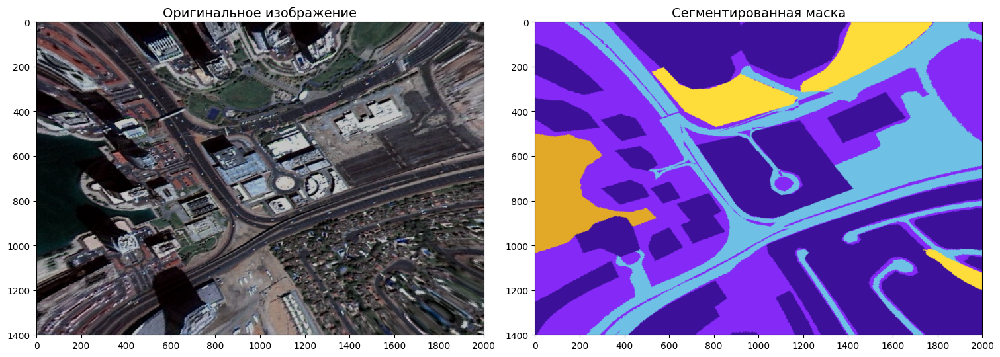

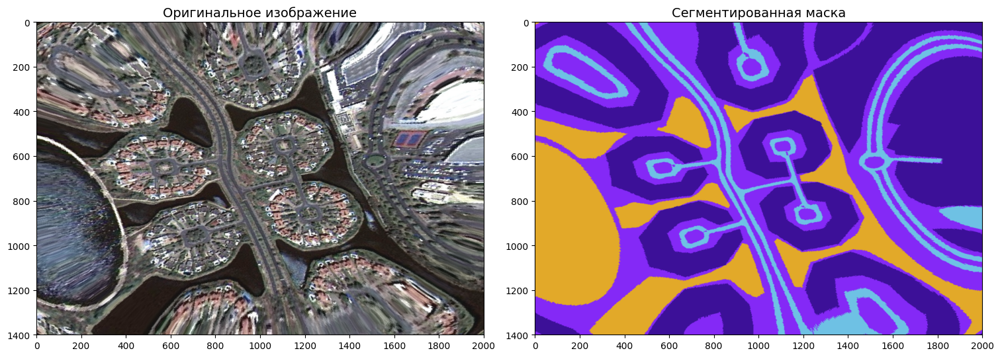

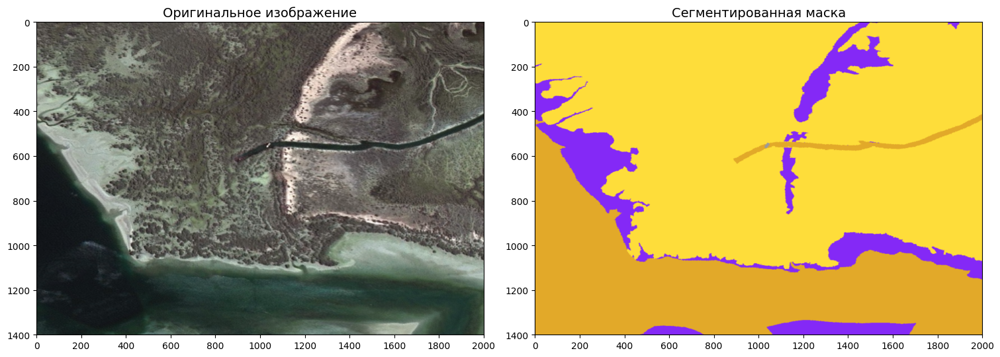

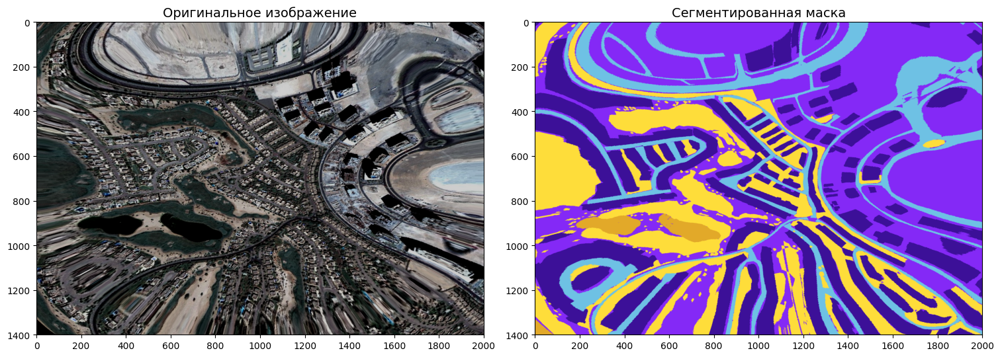

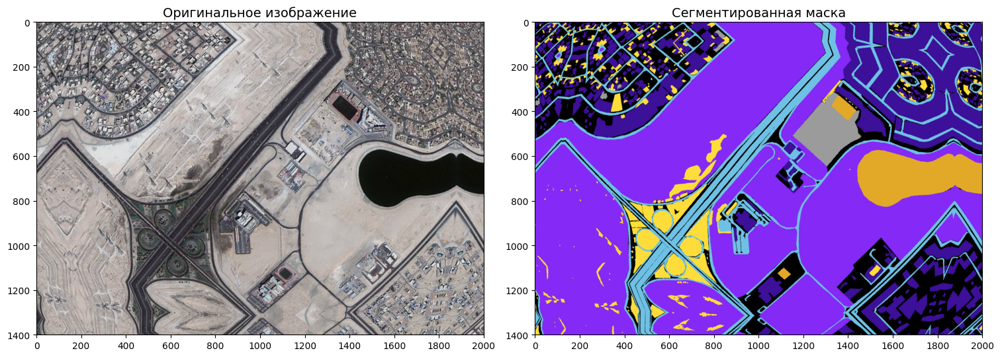

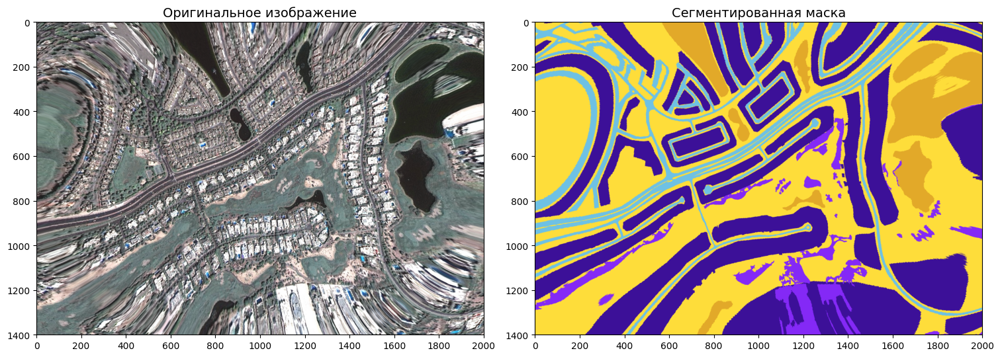

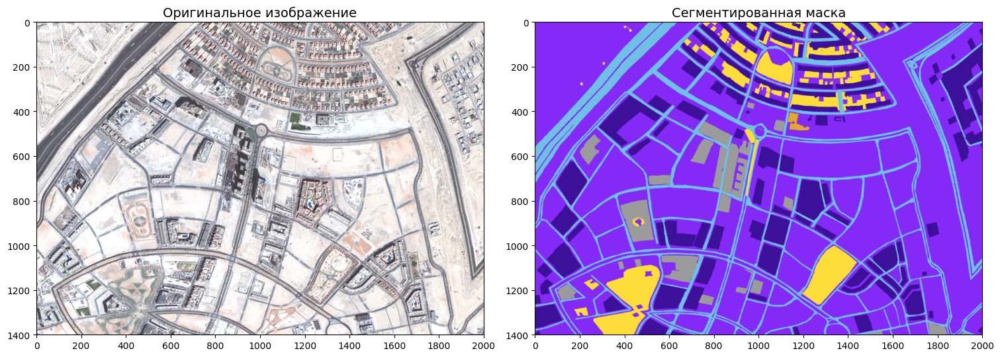

In [9]:
def show_data(files, original_images_dir, label_images_dir):

    for file in files:
        fig, axs = plt.subplots(1, 2, figsize=(15, 6), constrained_layout=True)
        axs[0].imshow(cv2.resize(cv2.imread(original_images_dir+'train/aug_1_'+str(file)+'.jpg'), (2000,1400)))
        axs[0].set_title('Оригинальное изображение', fontdict = {'fontsize':14, 'fontweight': 'medium'})
        axs[0].set_xticks(np.arange(0, 2001, 200))
        axs[0].set_yticks(np.arange(0, 1401, 200))
        axs[0].grid(False)
        axs[0].axis(True)

        semantic_label_image = cv2.imread(label_images_dir+ 'train/aug_1_'+str(file)+'.png')
        semantic_label_image = cv2.cvtColor(semantic_label_image, cv2.COLOR_BGR2RGB)
        semantic_label_image = cv2.resize(semantic_label_image, (2000,1400))
        axs[1].imshow(semantic_label_image)
        axs[1].set_title('Сегментированная маска', fontdict = {'fontsize':14, 'fontweight': 'medium'})
        axs[1].set_xticks(np.arange(0, 2001, 200))
        axs[1].set_yticks(np.arange(0, 1401, 200))
        axs[1].grid(False)
        axs[1].axis(True)

        plt.savefig('./sample_'+file, facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 100)
        plt.show()


files = ['image_t4_001', 'image_t4_005', 'image_t6_002', 'image_t7_002', 'image_t8_003', 'image_t8_004', 'image_t8_006']
show_data(files, train_images, train_masks)

### Визуализация аугментация

Будут выведены оригинальные картинки и маскаи, а также трансформированные (аугментированные) им соответсвия.

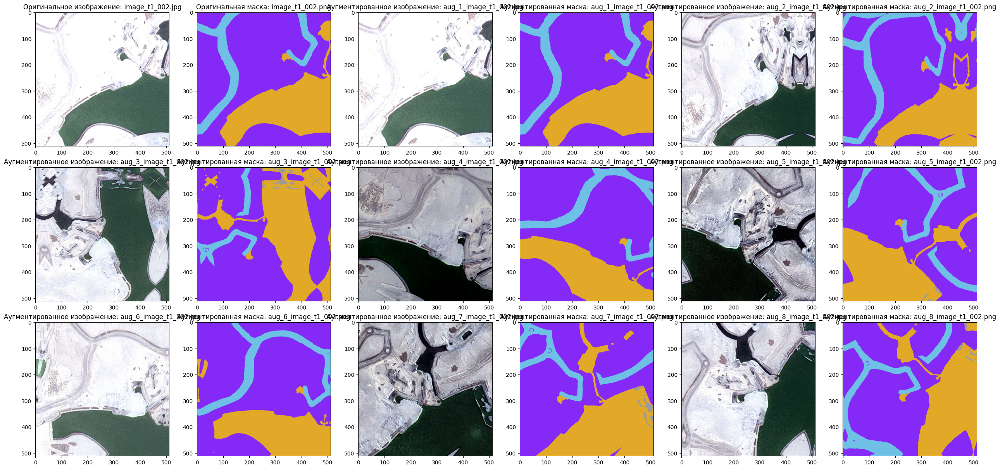

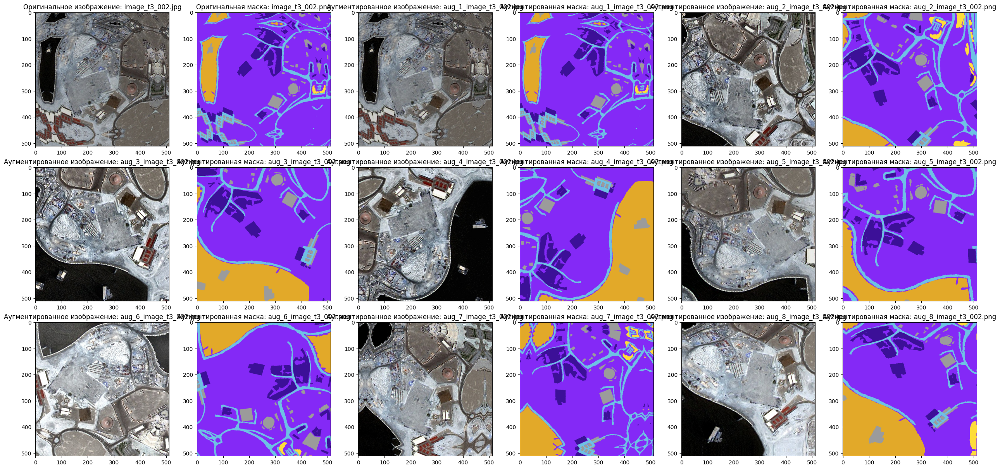

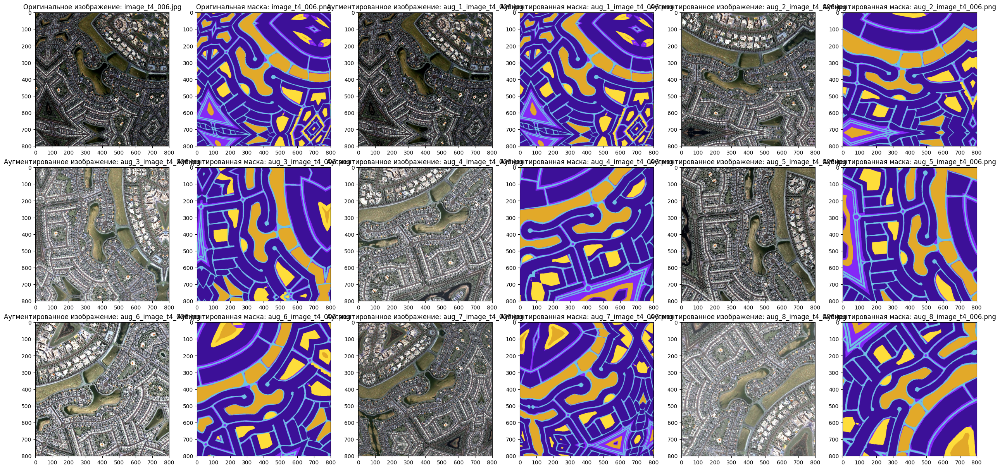

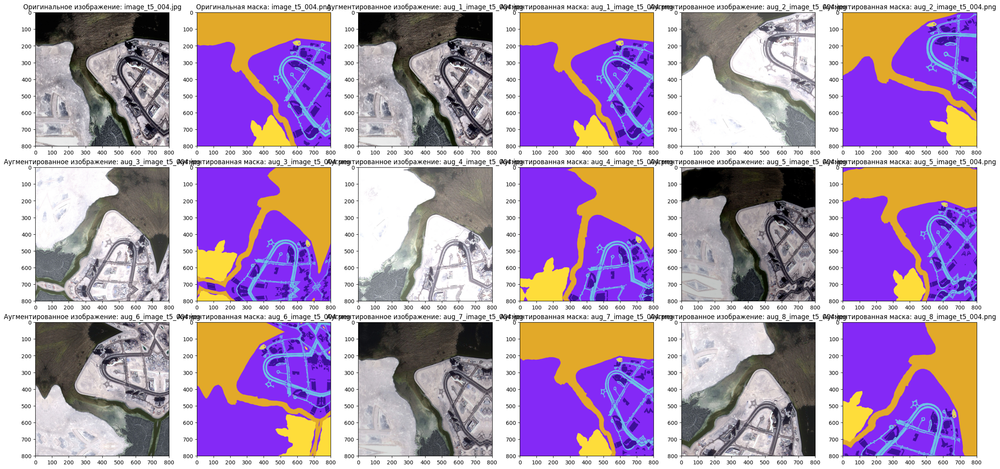

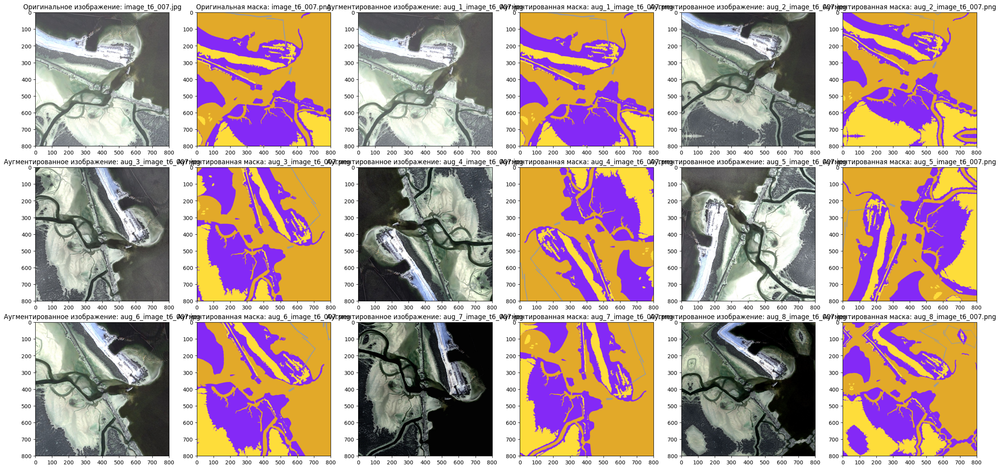

In [11]:
augmented_files = ['image_t1_002', 'image_t3_002', 'image_t4_006', 'image_t5_004', 'image_t6_007']
dims = np.array([(512, 512), (512, 512), (800, 800), (800, 800), (800, 800)])

def show_augmented_images(files, original_images_dir, label_images_dir):
    dim_index = 0
    for file in files:
        count_img = 1
        count_msk = 1
        fig, axs = plt.subplots(3, 6, figsize=(25, 12), constrained_layout=True)
        for i in range(3):
            for j in range(6):
                if i == 0 and j == 0:
                    axs[i][j].imshow(cv2.resize(cv2.cvtColor(cv2.imread(original_images_dir+'train/aug_1_'+str(file)+'.jpg'), cv2.COLOR_BGR2RGB), tuple(dims[dim_index])))
                    axs[i][j].set_title('Оригинальное изображение: {}.jpg'.format(file), fontdict = {'fontsize':12, 'fontweight': 'medium'})
                    axs[i][j].set_xticks(np.arange(0, dims[dim_index][0]+1, 100))
                    axs[i][j].set_yticks(np.arange(0, dims[dim_index][1]+1, 100))
                    axs[i][j].grid(False)
                    axs[i][j].axis(True)
                elif i == 0 and j == 1:
                    axs[i][j].imshow(cv2.resize(cv2.cvtColor(cv2.imread(label_images_dir+'train/aug_1_'+str(file)+'.png'), cv2.COLOR_BGR2RGB), tuple(dims[dim_index])))
                    axs[i][j].set_title('Оригинальная маска: {}.png'.format(file), fontdict = {'fontsize':12, 'fontweight': 'medium'})
                    axs[i][j].set_xticks(np.arange(0, dims[dim_index][0]+1, 100))
                    axs[i][j].set_yticks(np.arange(0, dims[dim_index][1]+1, 100))
                    axs[i][j].grid(False)
                    axs[i][j].axis(True)
                else:
                    if j%2 == 0:
                        axs[i][j].imshow(cv2.resize(cv2.cvtColor(cv2.imread(original_images_dir+'train/aug_'+str(count_img)+'_'+str(file)+'.jpg'), cv2.COLOR_BGR2RGB), tuple(dims[dim_index])))
                        axs[i][j].set_title('Аугментированное изображение: aug_{}.jpg'.format(str(count_img)+'_'+str(file)), fontdict = {'fontsize':12, 'fontweight': 'medium'})
                        axs[i][j].set_xticks(np.arange(0, dims[dim_index][0]+1, 100))
                        axs[i][j].set_yticks(np.arange(0, dims[dim_index][1]+1, 100))
                        axs[i][j].grid(False)
                        axs[i][j].axis(True)
                        count_img += 1
                    elif j%2 != 0:
                        axs[i][j].imshow(cv2.resize(cv2.cvtColor(cv2.imread(label_images_dir+'train/aug_'+str(count_msk)+'_'+str(file)+'.png'), cv2.COLOR_BGR2RGB), tuple(dims[dim_index])))
                        axs[i][j].set_title('Аугментированная маска: aug_{}.png'.format(str(count_msk)+'_'+str(file)), fontdict = {'fontsize':12, 'fontweight': 'medium'})
                        axs[i][j].set_xticks(np.arange(0, dims[dim_index][0]+1, 100))
                        axs[i][j].set_yticks(np.arange(0, dims[dim_index][1]+1, 100))
                        axs[i][j].grid(False)
                        axs[i][j].axis(True)
                        count_msk += 1

        plt.savefig('aug_image_'+file, facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 100)
        dim_index += 1
        plt.show()

show_augmented_images(augmented_files, train_images, train_masks)

### Словарь с описанем классов

Классы объектов с их цветовыми характеристиками взяты из семинара и записаны в csv файл, который загружаем в датафрейм пандаса.

In [12]:
class_dict_df = pd.read_csv('drive/MyDrive/class_dict.csv', index_col=False, skipinitialspace=True, sep='\t')
class_dict_df

,name,r,g,b
0,building,60,16,152
1,land,132,41,246
2,road,110,193,228
3,vegetation,254,221,58
4,water,226,169,41
5,unlabeled,155,155,155


### Метки классов

- class_dict_df - словарь с информацие о классах
- label_names Список имен классов (меток)
- label_codes - список кортежей RGB-кодов для каждого класса (метки)

In [13]:
label_names= list(class_dict_df.name)
label_codes = []
r= np.asarray(class_dict_df.r)
g= np.asarray(class_dict_df.g)
b= np.asarray(class_dict_df.b)

for i in range(len(class_dict_df)):
    label_codes.append(tuple([r[i], g[i], b[i]]))

label_codes, label_names

([(60, 16, 152),
  (132, 41, 246),
  (110, 193, 228),
  (254, 221, 58),
  (226, 169, 41),
  (155, 155, 155)],
 ['building', 'land', 'road', 'vegetation', 'water', 'unlabeled'])

### Классы в виде словарей

In [14]:
code2id = {v:k for k,v in enumerate(label_codes)}
id2code = {k:v for k,v in enumerate(label_codes)}

name2id = {v:k for k,v in enumerate(label_names)}
id2name = {k:v for k,v in enumerate(label_names)}

In [15]:
id2code

{0: (60, 16, 152),
 1: (132, 41, 246),
 2: (110, 193, 228),
 3: (254, 221, 58),
 4: (226, 169, 41),
 5: (155, 155, 155)}

In [16]:
id2name

{0: 'building',
 1: 'land',
 2: 'road',
 3: 'vegetation',
 4: 'water',
 5: 'unlabeled'}

### Функции категоризации

In [17]:
def rgb_to_onehot(rgb_image, colormap = id2code):
    '''Функция категоризации меток RGB в onehote
        Вход:
            rgb_image - матрица изображений (eg. 256 x 256 x 3 мерный массив нампая)
            colormap - словарь цветов и их id
        Выход: Категоризировання картинка резмерности (высота x ширина x кол-во_классов) где num_classes = len(colormap)
    '''
    num_classes = len(colormap)
    shape = rgb_image.shape[:2]+(num_classes,)
    encoded_image = np.zeros( shape, dtype=np.int8 )
    for i, cls in enumerate(colormap):
        encoded_image[:,:,i] = np.all(rgb_image.reshape( (-1,3) ) == colormap[i], axis=1).reshape(shape[:2])
    return encoded_image


def onehot_to_rgb(onehot, colormap = id2code):
    '''Функция категоризации onehote в RGB
        Вход:
            onehot - раскодированная матрица (высота x ширина x кол-во_классов)
            colormap - словарь цветов и их id
        Выход: Картинка закодированная в формат RGB (высота x ширина x 3)
    '''
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros( onehot.shape[:2]+(3,) )
    for k in colormap.keys():
        output[single_layer==k] = colormap[k]
    return np.uint8(output)

In [18]:
# Нормализуем только картинки, т.к. маска содежрит информацию о метках
data_gen_args = dict(rescale=1./255)
mask_gen_args = dict()

train_frames_datagen = ImageDataGenerator(**data_gen_args)
train_masks_datagen = ImageDataGenerator(**mask_gen_args)
val_frames_datagen = ImageDataGenerator(**data_gen_args)
val_masks_datagen = ImageDataGenerator(**mask_gen_args)

# Seed определеяет смещение картинки относительно маски
seed = 1

In [19]:
def TrainAugmentGenerator(train_images_dir, train_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
    '''Генератор обучающих изображений
        Вход:
            seed - seed передаются в функцию flow_from_directory function для согласованности потока
            batch_size - количество картинок импортируемых за раз
            train_images_dir - папка с обучающими снимками
            train_masks_dir - папка с обучающими масками
            target_size - целочисленный кортеж (высота, ширина)

        Выход: Декодированная RGB картинка (высота x ширина x 3)
    '''
    train_image_generator = train_frames_datagen.flow_from_directory(
    train_images_dir,
    batch_size = batch_size,
    seed = seed,
    target_size = target_size)

    train_mask_generator = train_masks_datagen.flow_from_directory(
    train_masks_dir,
    batch_size = batch_size,
    seed = seed,
    target_size = target_size)

    while True:
        X1i = train_image_generator.next()
        X2i = train_mask_generator.next()

        #One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)

def ValAugmentGenerator(val_images_dir, val_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
    '''Генератор валидационных картинок
        Вход:
            seed - seed передаются в функцию flow_from_directory function для согласованности потока
            batch_size - количество картинок импортируемых за раз
            val_images_dir - папка с валидационными картинками
            val_masks_dir - папка с валидационными масками
            target_size - целочисленный кортеж (высота, ширина)

        Выход: Декодированная RGB картинка (высота x ширина x 3)
    '''
    val_image_generator = val_frames_datagen.flow_from_directory(
    val_images_dir,
    batch_size = batch_size,
    seed = seed,
    target_size = target_size)


    val_mask_generator = val_masks_datagen.flow_from_directory(
    val_masks_dir,
    batch_size = batch_size,
    seed = seed,
    target_size = target_size)


    while True:
        X1i = val_image_generator.next()
        X2i = val_mask_generator.next()

        #One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)

### Модель

- batch_size - количество образцов, обрабатываемых за одну итерацию обучения = 16
- num_train_samples - количество обучающих образцов = 576 картинок
- num_val_samples - количество образцов валидации = 2 картинки
- steps_per_epoch - количество шагов (итераций) на каждую эпоху обучения = 576 / 16 = 36
- validation_steps - количество шагов (итераций) на каждую эпоху валидации = 4 * 576 / 16 = 144

In [20]:
batch_size = 16
num_train_samples = len(np.sort(os.listdir(train_images+'train')))
num_val_samples = len(np.sort(os.listdir(val_images+'train')))
steps_per_epoch = np.ceil(float(num_train_samples) / float(batch_size))
print('steps_per_epoch: ', steps_per_epoch)
validation_steps = np.ceil(float(4 * num_val_samples) / float(batch_size))
print('validation_steps: ', validation_steps)

steps_per_epoch:  36.0
validation_steps:  1.0


### Inception-ResNetV2 & Unet

Модель будет использовать включать две базовые архитектуры:
1. Inception-ResNetV2 - Это глубокая сверточная нейронная сеть, разработанная Google. Она является комбинацией двух популярных архитектур: Inception и ResNet.
2. UNet - Это нейронной сеть семантической сегментации изображений. Она состоит из энкодера (сверточная часть) и декодера (транспонированные свертки), который позволяет получить сегментированное изображение той же размерности, что и входное изображение.

In [21]:
def conv_block(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

def decoder_block(input, skip_features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

def build_inception_resnetv2_unet(input_shape):
    """ Input """
    inputs = Input(input_shape)

    """ Pre-trained InceptionResNetV2 Model """
    encoder = InceptionResNetV2(include_top=False, weights="imagenet", input_tensor=inputs)

    """ Encoder """
    s1 = encoder.get_layer("input_1").output           ## (512 x 512)

    s2 = encoder.get_layer("activation").output        ## (255 x 255)
    s2 = ZeroPadding2D(( (1, 0), (1, 0) ))(s2)         ## (256 x 256)

    s3 = encoder.get_layer("activation_3").output      ## (126 x 126)
    s3 = ZeroPadding2D((1, 1))(s3)                     ## (128 x 128)

    s4 = encoder.get_layer("activation_74").output      ## (61 x 61)
    s4 = ZeroPadding2D(( (2, 1),(2, 1) ))(s4)           ## (64 x 64)

    """ Bridge """
    b1 = encoder.get_layer("activation_161").output     ## (30 x 30)
    b1 = ZeroPadding2D((1, 1))(b1)                      ## (32 x 32)

    """ Decoder """
    d1 = decoder_block(b1, s4, 512)                     ## (64 x 64)
    d2 = decoder_block(d1, s3, 256)                     ## (128 x 128)
    d3 = decoder_block(d2, s2, 128)                     ## (256 x 256)
    d4 = decoder_block(d3, s1, 64)                      ## (512 x 512)

    """ Output """
    dropout = Dropout(0.3)(d4)
    outputs = Conv2D(6, 1, padding="same", activation="softmax")(dropout)

    model = Model(inputs, outputs, name="InceptionResNetV2-UNet")
    return model

### Вывод описания (статистики) модели

In [22]:
K.clear_session()

def dice_coef(y_true, y_pred):
    return (2. * K.sum(y_true * y_pred) + 1.) / (K.sum(y_true) + K.sum(y_pred) + 1.)

model = build_inception_resnetv2_unet(input_shape = (512, 512, 3))
model.compile(optimizer=Adam(lr = 0.0001), loss='categorical_crossentropy', metrics=[dice_coef, "accuracy"])
model.summary()

219055592/219055592 [==============================] - 2s 0us/step


Model: "InceptionResNetV2-UNet"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 255, 255, 32)         864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 255, 255, 32)         96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 255, 255, 32)         0         ['batch_n

### Графическое представление модели

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.631775 to fit



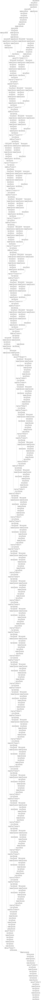

In [23]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True, expand_nested=True)

### Обратные вызовы

В процессе обучения модели, для получения обратной связи и контроля, будут выполняться "обратные вызовы":

1. exponential_decay_fn - функция экспоненциального зутухания, связана с функцией контроля скорости обучения, вызыватеся на каждой эпохе.
2. LearningRateScheduler - функция контроля скорости обучения
3. ModelCheckpoint - функция, сохраняющая состояние модели, на каждой эпохе
4. EarlyStopping - функция останавливающая обучение, если качество обучение, на основе валидационных данных, начинает ухуджаться
5. SVLogger - функция записи состояния модели (потери и метрики) в  model_training.csv на диск.

In [24]:
def exponential_decay(lr0, s):
    def exponential_decay_fn(epoch):
        return lr0 * 0.1 **(epoch / s)
    return exponential_decay_fn

exponential_decay_fn = exponential_decay(0.0001, 60)

lr_scheduler = LearningRateScheduler(
    exponential_decay_fn,
    verbose=1
)

checkpoint = ModelCheckpoint(
    filepath = 'InceptionResNetV2-UNet.h5',
    save_best_only = True,
#     save_weights_only = False,
    monitor = 'val_loss',
    mode = 'auto',
    verbose = 1
)

earlystop = EarlyStopping(
    monitor = 'val_loss',
    min_delta = 0.001,
    patience = 12,
    mode = 'auto',
    verbose = 1,
    restore_best_weights = True
)

csvlogger = CSVLogger(
    filename= "model_training.csv",
    separator = ",",
    append = False
)

callbacks = [checkpoint, earlystop, csvlogger, lr_scheduler]

### Обучение модели

In [25]:
history = model.fit(
    TrainAugmentGenerator(train_images_dir = train_images, train_masks_dir = train_masks, target_size = (512, 512)),
    steps_per_epoch=steps_per_epoch,
    validation_data = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512)),
    validation_steps = validation_steps,
    epochs = 50,
    callbacks=callbacks,
    use_multiprocessing=False,
    verbose=1
)

Found 576 images belonging to 1 classes.
Found 576 images belonging to 1 classes.

Epoch 1: LearningRateScheduler setting learning rate to 0.0001.
Epoch 1/50
36/36 [==============================] - ETA: 0s - loss: 1.2753 - dice_coef: 0.3853 - accuracy: 0.5568Found 2 images belonging to 1 classes.
Found 2 images belonging to 1 classes.

Epoch 1: val_loss improved from inf to 1.36707, saving model to InceptionResNetV2-UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


36/36 [==============================] - 278s 4s/step - loss: 1.2753 - dice_coef: 0.3853 - accuracy: 0.5568 - val_loss: 1.3671 - val_dice_coef: 0.2387 - val_accuracy: 0.8260 - lr: 1.0000e-04

Epoch 2: LearningRateScheduler setting learning rate to 9.623506263980886e-05.
Epoch 2/50
36/36 [==============================] - ETA: 0s - loss: 0.8946 - dice_coef: 0.5543 - accuracy: 0.6984
Epoch 2: val_loss improved from 1.36707 to 1.05698, saving model to InceptionResNetV2-UNet.h5
36/36 [==============================] - 144s 4s/step - loss: 0.8946 - dice_coef: 0.5543 - accuracy: 0.6984 - val_loss: 1.0570 - val_dice_coef: 0.3447 - val_accuracy: 0.8211 - lr: 9.6235e-05

Epoch 3: LearningRateScheduler setting learning rate to 9.261187281287936e-05.
Epoch 3/50
36/36 [==============================] - ETA: 0s - loss: 0.8059 - dice_coef: 0.5866 - accuracy: 0.7376
Epoch 3: val_loss improved from 1.05698 to 0.80127, saving model to InceptionResNetV2-UNet.h5
36/36 [==============================] - 8

### Статистика по метрикам в процессе обучения

In [26]:
df_result = pd.DataFrame(history.history)
df_result

,loss,dice_coef,accuracy,val_loss,val_dice_coef,val_accuracy,lr
0,1.275279,0.385296,0.556751,1.367073,0.238694,0.825993,0.000100
1,0.894608,0.554284,0.698383,1.056983,0.344654,0.821064,0.000096
2,0.805928,0.586621,0.737587,0.801271,0.464736,0.820820,0.000093
3,0.674488,0.644970,0.779217,0.580322,0.607964,0.828239,0.000089
4,0.656443,0.656474,0.786309,0.519431,0.642727,0.832127,0.000086
5,0.597286,0.686532,0.809180,0.480347,0.679800,0.823105,0.000083
6,0.521880,0.718475,0.832895,0.387231,0.775156,0.844889,0.000079
7,0.510765,0.729568,0.837221,0.383209,0.773993,0.840040,0.000076
8,0.462657,0.752416,0.851986,0.333630,0.783951,0.855967,0.000074
9,0.455174,0.752499,0.854194,0.316277,0.808507,0.859600,0.000071


### Визуализации метрик процесса обучения

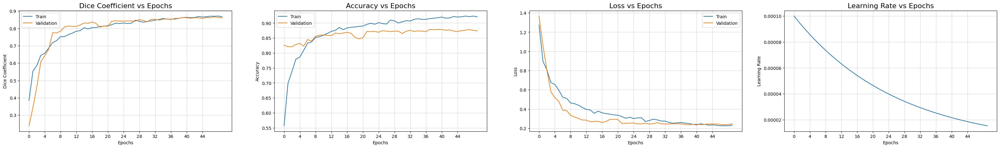

In [27]:
fig, ax = plt.subplots(1, 4, figsize=(40, 5))
ax = ax.ravel()
metrics = ['Dice Coefficient', 'Accuracy', 'Loss', 'Learning Rate']

for i, met in enumerate(['dice_coef', 'accuracy', 'loss', 'lr']):
    if met != 'lr':
        ax[i].plot(history.history[met])
        ax[i].plot(history.history['val_' + met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,45,4))
        ax[i].legend(['Train', 'Validation'])
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
    else:
        ax[i].plot(history.history[met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,45,4))
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")

plt.savefig('model_metrics_plot.png', facecolor= 'w',transparent= False, bbox_inches= 'tight', dpi= 150)

### Визуальное сравение реальных данных с предсказанными

In [28]:
model.load_weights("./InceptionResNetV2-UNet.h5")

In [29]:
testing_gen = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512))

In [30]:
!mkdir predictions

Found 2 images belonging to 1 classes.
Found 2 images belonging to 1 classes.
1/1 [==============================] - 3s 3s/step


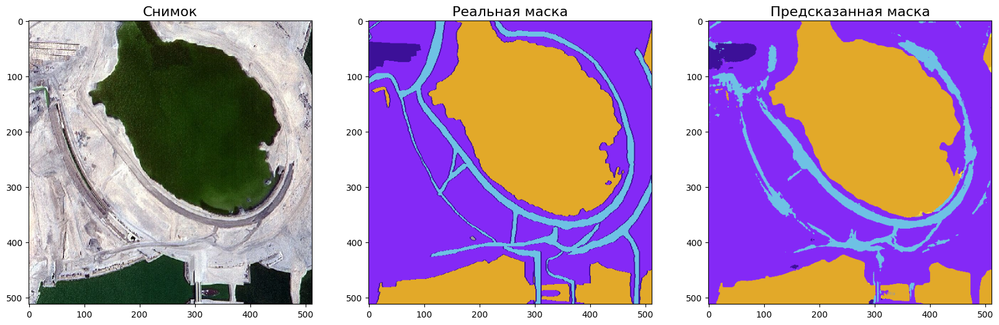

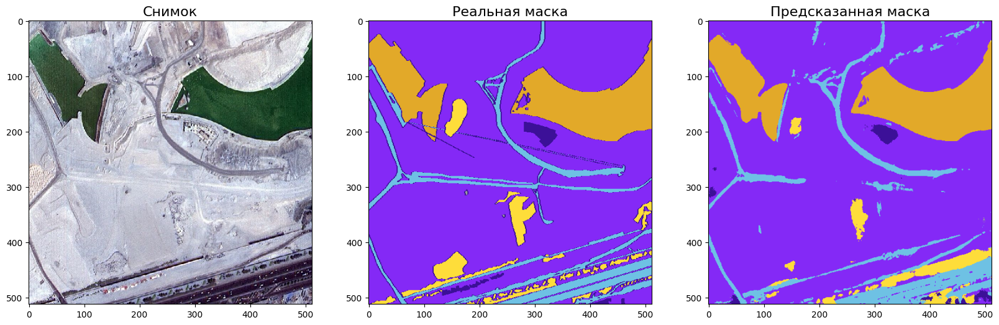

1/1 [==============================] - 0s 36ms/step


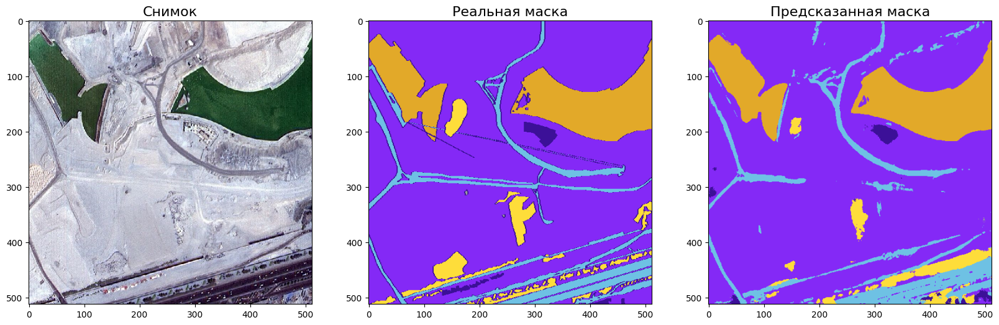

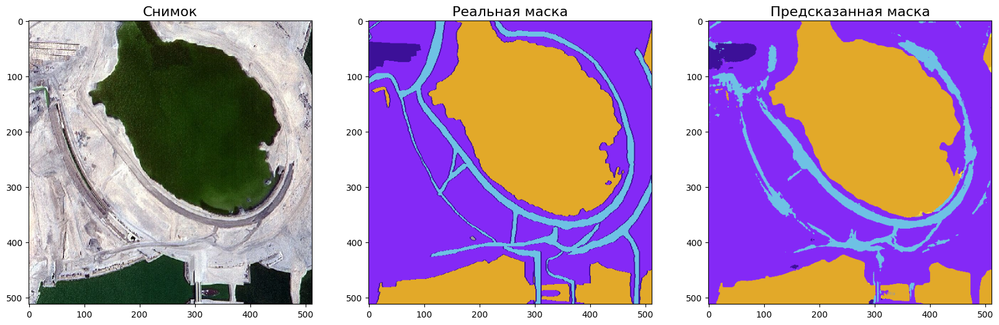

In [32]:
count = 0
for i in range(2):
    batch_img,batch_mask = next(testing_gen)
    pred_all= model.predict(batch_img)
    np.shape(pred_all)

    for j in range(0,np.shape(pred_all)[0]):
        count += 1
        fig = plt.figure(figsize=(20,8))

        ax1 = fig.add_subplot(1,3,1)
        ax1.imshow(batch_img[j])
        ax1.set_title('Снимок', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax1.grid(False)

        ax2 = fig.add_subplot(1,3,2)
        ax2.set_title('Реальная маска', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax2.imshow(onehot_to_rgb(batch_mask[j],id2code))
        ax2.grid(False)

        ax3 = fig.add_subplot(1,3,3)
        ax3.set_title('Предсказанная маска', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax3.imshow(onehot_to_rgb(pred_all[j],id2code))
        ax3.grid(False)

        plt.savefig('./predictions/prediction_{}.png'.format(count), facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 200)
        plt.show()